In [1]:
import glob
import os
import zipfile
import codecs

import pandas as pd
import pickle as pkl
import random

# we are going to use tweet tokenizer because the length of the dialogue exchanges are short like tweets
from nltk.tokenize import word_tokenize, TweetTokenizer
tokenizer = TweetTokenizer(preserve_case = False)

from gensim.models import Word2Vec, KeyedVectors

import re
import numpy as np
import pandas as pd
from pprint import pprint

# Gensim
import gensim
import gensim.corpora as corpora
from gensim.utils import simple_preprocess
from gensim.models import CoherenceModel

import matplotlib.pyplot as plt
%matplotlib inline

# Enable logging for gensim - optional
import logging
logging.basicConfig(format='%(asctime)s : %(levelname)s : %(message)s', level=logging.ERROR)

import warnings
warnings.filterwarnings("ignore",category=DeprecationWarning)

import os
import re
import pandas as pd
import numpy as np
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords

import nltk
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords

import numpy as np
import pandas as pd
from sklearn.feature_extraction.text import CountVectorizer 
from sklearn.decomposition import TruncatedSVD
from sklearn.decomposition import NMF
from sklearn.metrics.pairwise import cosine_similarity

import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.feature_extraction import text
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import KMeans
from nltk.tokenize import RegexpTokenizer
from nltk.stem.snowball import SnowballStemmer
%matplotlib inline

## Intro: EDA and Cleaning

In [2]:
def clean_text(text):
    """
    Applies some pre-processing on the given text.
    
    - Removes stage directions, some proper pronouns, and special characters 
    - Removes punctuation
    - Lowering text
    """
     
#     # remove the characters [\], ['] and ["]
#     text = text.replace('C', "", text)    
    text = re.sub(r"\'", "", text)    
#     text = re.sub(r"\"", "", text)    
    
    # remove numbers
    text = re.sub('\d', '', text)

    
    # remove special characters / words
    text = text.replace('\n', ' ')
    text = text.replace('CUT TO:', '')
    text = text.replace('PAUSE', '')
    text = text.replace('TITLE:', '')
    text = text.replace('(CONT\'D)', '')
    text = text.replace('(V.O.)', '')
    text = text.replace('  ', ' ') 
    text = text.replace('DISSOLVE TO', '')
    text = text.replace('THE END', '')
    text = text.replace('INTERCUT WITH', '')
    text = text.replace('CONTD', '')
    text = text.replace('contd', '')
    text = text.replace('CUT TO', '')
    text = text.replace('Postman', '')
    text = text.replace('shrek final', '')
    text = text.replace('screening', '')
    text = text.replace('screening script', '')
    text = text.replace('shrek', '')
    text = text.replace('final screening', '')
    text = text.replace('revision', '')
    text = text.replace('final revision', '')
    text = text.replace('www', '')
    text = text.replace('screentalk org', '')
    text = text.replace('org', '')
    text = text.replace('screentalk', '')
    text = text.replace('www screentalk', '')

    
    # replace punctuation characters with spaces
    filters='!"\'#$%&()*+,-./;<=>?@[\\]^_`{|}~\t\n•'
    translate_dict = dict((c, " ") for c in filters)
    translate_map = str.maketrans(translate_dict)
    text = text.translate(translate_map)
    
    #replace headers
    text = text.replace('Written by', '')
    text = text.replace('Screenplay by', '')
    text = text.replace('Guardians Screening Script', '')
    
    #remove multiple whitespaces
    text = re.sub(' +', ' ', text)
    

    return text

In [3]:
import glob

def read_file(file):
    """Reads in an individual file.

    Returns
    -------
    str
        the first line text of the input file
    """
    with open(file, 'rt') as fd:
        read = fd.read()
    return read

def merge_per_folder(folder_path, output_filename):
    """Merges text files in one folder, and
    writes combined lines into new output file

    Parameters
    ----------
    folder_path : str
        String representation of the folder path containing the text files.
    output_filename : str
        Name of the output file the merged lines will be written to.
    """
    # make sure there's a slash to the folder path 
    folder_path += "" if folder_path[-1] == "/" else "/"
    # get all text files
    txt_files = glob.glob(folder_path + "*.txt")
    # get first lines; map to each text file (sorted)
    output_strings = map(read_file, sorted(txt_files))
    output_content = "".join(output_strings)
    # write to file
    with open(folder_path + output_filename, 'wt') as outfile:
        outfile.write(output_content)

In [4]:
# test the read file and see what outputs
read_file('127hours_dialog.txt')


'127 HOURS\n\nWritten by\n\nSimon Beaufoy & Danny Boyle\n\nCUT TO:\n\nCUT TO:\n\n2.\n\nCUT TO:\n\nCUT TO:\n\nCUT TO:\n\nCUT TO:\n\nCUT TO:\n\nCUT TO:\n\n3.\n\nCUT TO:\n\nCUT TO:\n\nCUT TO:\n\nARON\n\nNearly missed it!\n\nCUT TO:\n\nCUT TO:\n\nCUT TO:\n\n4.\n\nCUT TO:\n\nCUT TO:\n\nCUT TO:\n\nCUT TO:\n\nCUT TO:\n\n5.\n\nCUT TO:\n\nCUT TO:\n\nCUT TO:\n\nCUT TO:\n\nCUT TO:\n\n6.\n\nCUT TO:\n\nARON\n\nHey. Are you doing the east pike?\n\nCan I come along with you for a\n\nwhile?\n\nARON (CONT\'D)\n\nI\'m on my own. I\'m Aron.\n\nCUT TO:\n\nKRISTI\n\n(looking at Megan)\n\nSure, I\'m Kristi.\n\nMEGAN\n\nMegan.\n\nARON\n\nNice to meet you. What a day.\n\nKRISTI\n\nIt\'s beautiful.\n\nARON\n\nDid you bike or come straight from\n\nthe trail head?\n\nKRISTI\n\nWe left the car there. Pretty\n\nquiet.\n\nARON\n\nI left mine at the Horseshoe Canyon\n\nand biked here.\n\n7.\n\nMEGAN\n\nYou biked from Horseshoe? That\'s\n\n20 miles or more.\n\nARON\n\n17 and windy.\n\nARON (CONT\'D)\n\nI do this a lo

In [5]:
# merges all txt dialog files together into one
# commenting this out
# merge_per_folder('/Users/nicksherwin/Desktop/Project_github/Project 4/dialogs/Adventure', 'all_dialog.txt')

In [6]:
with codecs.open('all_dialog', 'r', 'utf8') as f:
    
    f = f.read()


In [7]:
# check output
f 

'127 HOURS\n\nWritten by\n\nSimon Beaufoy & Danny Boyle\n\nCUT TO:\n\nCUT TO:\n\n2.\n\nCUT TO:\n\nCUT TO:\n\nCUT TO:\n\nCUT TO:\n\nCUT TO:\n\nCUT TO:\n\n3.\n\nCUT TO:\n\nCUT TO:\n\nCUT TO:\n\nARON\n\nNearly missed it!\n\nCUT TO:\n\nCUT TO:\n\nCUT TO:\n\n4.\n\nCUT TO:\n\nCUT TO:\n\nCUT TO:\n\nCUT TO:\n\nCUT TO:\n\n5.\n\nCUT TO:\n\nCUT TO:\n\nCUT TO:\n\nCUT TO:\n\nCUT TO:\n\n6.\n\nCUT TO:\n\nARON\n\nHey. Are you doing the east pike?\n\nCan I come along with you for a\n\nwhile?\n\nARON (CONT\'D)\n\nI\'m on my own. I\'m Aron.\n\nCUT TO:\n\nKRISTI\n\n(looking at Megan)\n\nSure, I\'m Kristi.\n\nMEGAN\n\nMegan.\n\nARON\n\nNice to meet you. What a day.\n\nKRISTI\n\nIt\'s beautiful.\n\nARON\n\nDid you bike or come straight from\n\nthe trail head?\n\nKRISTI\n\nWe left the car there. Pretty\n\nquiet.\n\nARON\n\nI left mine at the Horseshoe Canyon\n\nand biked here.\n\n7.\n\nMEGAN\n\nYou biked from Horseshoe? That\'s\n\n20 miles or more.\n\nARON\n\n17 and windy.\n\nARON (CONT\'D)\n\nI do this a lo

In [8]:
# apply 
cleaned_df = clean_text(f)

In [9]:
cleaned_df

' HOURS Simon Beaufoy Danny Boyle ARON Nearly missed it ARON Hey Are you doing the east pike Can I come along with you for a while ARON Im on my own Im Aron KRISTI looking at Megan Sure Im Kristi MEGAN Megan ARON Nice to meet you What a day KRISTI Its beautiful ARON Did you bike or come straight from the trail head KRISTI We left the car there Pretty quiet ARON I left mine at the Horseshoe Canyon and biked here MEGAN You biked from Horseshoe Thats miles or more ARON and windy ARON I do this a lot ARON Wasnt expecting to see anyone in the canyon today MEGAN Yeah you surprised us sneaking up like that ARON Sorry MEGAN Its kind of nervy seeing a lone guy walking up to you in the middle of the desert ARON Yeah I know I mean theres no one around for miles KRISTI and suddenly theres a guy right behind you and wait a minute why is he wearing a HOCKEY MASK ARON Let me guess Youre here for the paintings or the Cathedral KRISTI The Cathedral Weve got a bit disorientated and the map isnt great Wh

In [10]:
# regex to find and separate all characters in the scripts
speaker = re.findall(r"([A-Z]+\s?[A-Z]+[^a-z0-9\W])",cleaned_df)


In [11]:
speaker

['HOURS',
 'ARON',
 'ARON',
 'ARON',
 'KRISTI',
 'MEGAN',
 'ARON',
 'KRISTI',
 'ARON',
 'KRISTI',
 'ARON',
 'MEGAN',
 'ARON',
 'ARON',
 'ARON',
 'MEGAN',
 'ARON',
 'MEGAN',
 'ARON',
 'KRISTI',
 'HOCKEY MASK',
 'ARON',
 'KRISTI',
 'ARON',
 'KRISTI MEGAN',
 'ARON',
 'MEGAN',
 'ARON',
 'ARON',
 'ARON',
 'KRISTI OMG',
 'MEGAN',
 'ARON KRISTI',
 'KRISTI',
 'MEGAN',
 'MEGAN',
 'KRISTI',
 'ARON',
 'MEGAN',
 'KRISTI',
 'MEGAN',
 'ARON',
 'KRISTI',
 'ARON',
 'MEGAN',
 'ARON',
 'KRISTI',
 'MEGAN',
 'ARON',
 'MEGAN',
 'MOTEL',
 'ARON',
 'MOTEL',
 'KRISTI',
 'ARON',
 'ARON',
 'MEGAN',
 'KRISTI',
 'ARON',
 'LAUGHS',
 'ARON',
 'ARON',
 'ARON',
 'MEGAN',
 'ARON',
 'KRISTI',
 'ARON',
 'KRISTI',
 'MEGAN',
 'KRISTI',
 'ARON',
 'MEGAN',
 'MEGAN',
 'ARON',
 'KRISTI',
 'ARON',
 'MEGAN',
 'ARON',
 'MEGAN',
 'ARON',
 'ARON',
 'KRISTI',
 'MEGAN',
 'ARON',
 'KRISTI',
 'ARON',
 'KRISTI',
 'ARON',
 'MEGAN',
 'ARON',
 'CD RECORDING',
 'PHISH PHOTOTIME',
 'ARON',
 'ARON',
 'HOURS ARON',
 'FUCK',
 'ARON SHIT',
 'SH

In [12]:
# regex to find and separate all dialogue from the speakers/characters
dialogue = re.compile('[A-Z]+\s?[A-Z]+[^a-z0-9\W]').split(cleaned_df)[1:]


In [13]:
dialogue

[' Simon Beaufoy Danny Boyle ',
 ' Nearly missed it ',
 ' Hey Are you doing the east pike Can I come along with you for a while ',
 ' Im on my own Im Aron ',
 ' looking at Megan Sure Im Kristi ',
 ' Megan ',
 ' Nice to meet you What a day ',
 ' Its beautiful ',
 ' Did you bike or come straight from the trail head ',
 ' We left the car there Pretty quiet ',
 ' I left mine at the Horseshoe Canyon and biked here ',
 ' You biked from Horseshoe Thats miles or more ',
 ' and windy ',
 ' I do this a lot ',
 ' Wasnt expecting to see anyone in the canyon today ',
 ' Yeah you surprised us sneaking up like that ',
 ' Sorry ',
 ' Its kind of nervy seeing a lone guy walking up to you in the middle of the desert ',
 ' Yeah I know I mean theres no one around for miles ',
 ' and suddenly theres a guy right behind you and wait a minute why is he wearing a ',
 ' ',
 ' Let me guess Youre here for the paintings or the Cathedral ',
 ' The Cathedral Weve got a bit disorientated and the map isnt great Where 

In [14]:
# create a dataframe that marries the character with each dialogue line
movie_df = pd.DataFrame(list(zip(speaker, dialogue)), columns=['Character', 'Dialogue'])

In [15]:
movie_df.head()

,Character,Dialogue
0,HOURS,Simon Beaufoy Danny Boyle
1,ARON,Nearly missed it
2,ARON,Hey Are you doing the east pike Can I come al...
3,ARON,Im on my own Im Aron
4,KRISTI,looking at Megan Sure Im Kristi


In [16]:
movie_df.shape

(126599, 2)

In [17]:
# filter for characters that have more than 100 unique lines of dialogue
movie_df = movie_df.groupby('Character').filter(lambda x: len(x) > 100)


In [18]:
# lowercase all words in the dialogue column for easier processing
movie_df['Dialogue'] = movie_df['Dialogue'].str.lower()

In [19]:
# take out dialogue instances of less than 3 words as they are lot helpful for our analysis
movie_df = movie_df[movie_df.Dialogue.str.count(' ') > 3]


In [20]:
movie_df.shape

(40543, 2)

In [21]:
movie_df.head()

,Character,Dialogue
1,ARON,nearly missed it
2,ARON,hey are you doing the east pike can i come al...
3,ARON,im on my own im aron
6,ARON,nice to meet you what a day
8,ARON,did you bike or come straight from the trail ...


In [22]:
# print unique names in the character list to see all protagonists
movie_df.Character.unique()

array(['ARON', 'VOICE', 'PILOT', 'COLUMBUS', 'MAN', 'HAL', 'MOTHER',
       'JACKSON', 'KATE', 'HARRY', 'TONY', 'TAMARA', 'WEST', 'BEAT',
       'WILL', 'CHET', 'DWAYNE', 'JAY', 'VAUGHN', 'GUARD', 'BUD',
       'LINDSEY', 'WOMAN', 'GUY', 'MARSHALL', 'GIBBS', 'KORSHUNOV',
       'MIKE', 'BALA', 'ARTHUR', 'HENRY', 'JOHN', 'JAKE', 'MAX', 'GRACE',
       'NICK FURY', 'STEVE', 'HAWKEYE', 'EMMA', 'PETER', 'STEED',
       'EDWARD', 'JENNY', 'ELI', 'CARNEGIE', 'SOLARA', 'BOURNE', 'MARIE',
       'DAY', 'VOSEN', 'HAMMOND', 'FLASH', 'LUCY', 'STEPHEN', 'BLOOM',
       'VICTOR', 'PENELOPE', 'CONTINUED', 'NIGHT', 'FINN', 'MATER',
       'MCQUEEN', 'HOLLEY', 'CHUCK', 'KELLY', 'JACK', 'MARY', 'GABE',
       'DAVID', 'CONAN', 'CORALINE', 'CHARLIE', 'EEP', 'GRUG', 'JEN',
       'DUNBAR', 'WILLIE', 'GRU', 'HAWK', 'LEX', 'GALEN', 'VALERIAN',
       'LLOYD', 'BILLY', 'HELEN', 'PAUL', 'JESSICA', 'MERLIN', 'REED',
       'BEN', 'SUE', 'ANNA', 'ELSA', 'KRISTOFF', 'KIMBLE', 'GERARD',
       'FLYNN', 'PATTERSO

In [23]:
movie_df.Character.value_counts()


JACK                   987
WILL                   554
HARRY                  532
PICARD                 489
BEN                    487
CHUCK                  476
BRODY                  454
KIRK                   446
LUKE                   445
ARTHUR                 420
INDIANA                416
ETHAN                  412
INDY                   410
BOND                   408
EPPS                   401
COBB                   398
ELI                    389
KUMAR                  369
MILES                  365
HAWK                   341
THE POSTMAN            324
VOICE                  305
TONY                   303
ROBIN                  301
JAY                    300
HAN                    298
BOURNE                 298
JENNY                  296
LLOYD                  292
HAROLD                 280
                      ... 
JONATHAN                96
WORF                    96
BUNNYMUND               95
DOCTOR PARNASSUS        95
GUARD                   95
GREER                   94
E

## I. Text Preprocessing

In [24]:
# import additional modules for our preprocessing phase

import spacy
import pandas as pd
import numpy as np
import nltk
from nltk.tokenize.toktok import ToktokTokenizer
import re
from bs4 import BeautifulSoup
from contractions import CONTRACTION_MAP
import unicodedata
nlp = spacy.load('en', parse=True, tag=True, entity=True)
#nlp_vec = spacy.load('en_vecs', parse = True, tag=True, #entity=True)
tokenizer = ToktokTokenizer()
stopword_list = nltk.corpus.stopwords.words('english')
stopword_list.remove('no')
stopword_list.remove('not')

Before we can move forward with vectorizing and performing dimensionality reduction on our dataframe, we will need to do some additional preparation and preprocessing. Below are a number of functions to help us do so.

In [25]:
def remove_accented_chars(text):
    text = unicodedata.normalize('NFKD', text).encode('ascii', 'ignore').decode('utf-8', 'ignore')
    return text

In [26]:
def expand_contractions(text, contraction_mapping=CONTRACTION_MAP):
    
    contractions_pattern = re.compile('({})'.format('|'.join(contraction_mapping.keys())), 
                                      flags=re.IGNORECASE|re.DOTALL)
    def expand_match(contraction):
        match = contraction.group(0)
        first_char = match[0]
        expanded_contraction = contraction_mapping.get(match)\
                                if contraction_mapping.get(match)\
                                else contraction_mapping.get(match.lower())                       
        expanded_contraction = first_char+expanded_contraction[1:]
        return expanded_contraction
        
    expanded_text = contractions_pattern.sub(expand_match, text)
    expanded_text = re.sub("'", "", expanded_text)
    return expanded_text

In [27]:
def remove_special_characters(text, remove_digits=False):
    pattern = r'[^a-zA-z0-9\s]' if not remove_digits else r'[^a-zA-z\s]'
    text = re.sub(pattern, '', text)
    return text

In [28]:
# function to stem our text
def simple_stemmer(text):
    ps = nltk.porter.PorterStemmer()
    text = ' '.join([ps.stem(word) for word in text.split()])
    return text

In [29]:
# function to lemmatize our text
def lemmatize_text(text):
    text = nlp(text)
    text = ' '.join([word.lemma_ if word.lemma_ != '-PRON-' else word.text for word in text])
    return text

In [30]:
def remove_stopwords(text, is_lower_case=False):
    tokens = tokenizer.tokenize(text)
    tokens = [token.strip() for token in tokens]
    if is_lower_case:
        filtered_tokens = [token for token in tokens if token not in stopword_list]
    else:
        filtered_tokens = [token for token in tokens if token.lower() not in stopword_list]
    filtered_text = ' '.join(filtered_tokens)    
    return filtered_text

In [31]:
def normalize_corpus(corpus, html_stripping=True, contraction_expansion=True,
                     accented_char_removal=True, text_lower_case=True, 
                     text_lemmatization=True, special_char_removal=True, 
                     stopword_removal=True, remove_digits=True):
    
    normalized_corpus = []
    # normalize each document in the corpus
    for doc in corpus:
        # remove accented characters
        if accented_char_removal:
            doc = remove_accented_chars(doc)
        # expand contractions    
        if contraction_expansion:
            doc = expand_contractions(doc)
        # lowercase the text    
        if text_lower_case:
            doc = doc.lower()
        # remove extra newlines
        doc = re.sub(r'[\r|\n|\r\n]+', ' ',doc)
        # lemmatize text
        if text_lemmatization:
            doc = lemmatize_text(doc)
        # remove special characters and\or digits    
        if special_char_removal:
            # insert spaces between special characters to isolate them    
            special_char_pattern = re.compile(r'([{.(-)!}])')
            doc = special_char_pattern.sub(" \\1 ", doc)
            doc = remove_special_characters(doc, remove_digits=remove_digits)  
        # remove extra whitespace
        doc = re.sub(' +', ' ', doc)
        # remove stopwords
        if stopword_removal:
            doc = remove_stopwords(doc, is_lower_case=text_lower_case)
            
        normalized_corpus.append(doc)
        
    return normalized_corpus

In [32]:
# combining character and dialogue as a new column
movie_df['full_text'] = movie_df["Character"].map(str)+ '. ' + movie_df["Dialogue"]

# run above preprocessing functions on the dialogue and create as another new column in the df
movie_df['clean_text'] = normalize_corpus(movie_df['full_text'])
norm_corpus = list(movie_df['clean_text'])

# show a sample dialogue
movie_df.iloc[1][['full_text', 'clean_text']].to_dict()

{'full_text': 'ARON.  hey are you doing the east pike can i come along with you for a while ',
 'clean_text': 'aron hey east pike come along'}

In [34]:
movie_df.head()

,Character,Dialogue,full_text,clean_text
1,ARON,nearly missed it,ARON. nearly missed it,aron nearly miss
2,ARON,hey are you doing the east pike can i come al...,ARON. hey are you doing the east pike can i c...,aron hey east pike come along
3,ARON,im on my own im aron,ARON. im on my own im aron,aron aron
6,ARON,nice to meet you what a day,ARON. nice to meet you what a day,aron nice meet day
8,ARON,did you bike or come straight from the trail ...,ARON. did you bike or come straight from the ...,aron bike come straight trail head


In [35]:
movie_df.tail()

,Character,Dialogue,full_text,clean_text
126589,XANDER,oh yeah why dont we start by taking this thin...,XANDER. oh yeah why dont we start by taking t...,xander oh yeah not start take thing ankle pois...
126591,XANDER,no needles huh what about the acid bath,XANDER. no needles huh what about the acid bath,xander no needle huh acid bath
126593,XANDER,smiles youre a jerk off you know that,XANDER. smiles youre a jerk off you know that,xander smile jerk know
126596,XANDER,you cant welch on me now we had a deal :,XANDER. you cant welch on me now we had a dea...,xander not welch deal
126598,XANDER,its about your next mission you need to be de...,XANDER. its about your next mission you need ...,xander next mission need debrief


In [36]:
# preview dialogue formatting for a single character
xander = movie_df.loc[movie_df.Character == 'XANDER']
print(xander)



       Character                                           Dialogue  \
125959    XANDER   sky you there start packin cause we are out o...   
125960    XANDER   did i promise you a fat vacation or what get ...   
125961    XANDER   hey you dont need all this just to go on vaca...   
125963    XANDER                                i can see that why    
125965    XANDER                   im having fun whats the problem    
125967    XANDER   i dont wanna go mersh you know that but hey i...   
125968    XANDER   i got an advance on the next bootleg lets get...   
125970    XANDER                           alright so ill get more    
125972    XANDER   well if youre bailing i guess id better give ...   
125974    XANDER             i was gonna wait till the islands but    
125976    XANDER            of course im serious i bought it didnt    
125978    XANDER   i dont know i thought this is what you wanted...   
125980    XANDER         youre not exactly going anywhere yourself    
125982

In [37]:
# define a new character list that takes out some noise that we had before. These are all legitimate characters/protagonists.
char_list = ['ARON', 'PILOT', 'COLUMBUS', 'SOLDIER',
       'HAL', 'MOTHER', 'WEST', 'ADRIAN', 'JACKSON', 'KATE',
       'HARRY', 'TONY', 'TAMARA', 'BEAT', 'WILL', 'CHET', 'DWAYNE', 'JAY',
       'VAUGHN', 'BUD', 'LINDSEY', 'WOMAN', 'GUY', 'BLACK', 'MARSHALL',
       'GIBBS', 'KORSHUNOV', 'ALICE', 'BALA', 'ASH', 
       'ARTHUR', 'HENRY', 'BRIDGE', 'JAKE', 'MAX', 'GRACE',
       'NICK FURY', 'STEVE', 'HAWKEYE', 'EMMA', 'PETER', 'STEED',
       'EDWARD', 'JENNY', 'ELI', 'CARNEGIE', 'SOLARA',
       'BOURNE', 'MARIE', 'VOSEN', 'LUCY', 'HAMMOND', 'FLASH',
       'BLOOM', 'STEPHEN', 'VICTOR', 'PENELOPE', 'FINN',
       'MATER', 'MCQUEEN', 'HOLLEY', 'CHUCK', 'KELLY', 'JACK', 'AMANDA',
       'MARY', 'JOHN', 'ASLAN', 'GABE', 'DAVID', 'CONAN', 'CORALINE',
       'CHARLIE', 'GRUG', 'JEN', 'MAY', 'FOX', 'DUNBAR', 'WILLIE',
       'GRU', 'HAWK', 'LEX', 'CALVIN CANDIE', 'GALEN',
       'VALERIAN', 'LLOYD', 'BILLY', 'HELEN', 'PAUL', 'JESSICA',
       'MERLIN', 'REED', 'BEN', 'SUE', 'JOHNNY', 'ELSA', 'ANNA',
       'KRISTOFF', 'OLAF', 'KIMBLE', 'GERARD', 'FLYNN', 'PATTERSON',
       'DANA', 'STANTZ', 'VENKMAN', 'LOUIS', 'EPPS', 'GREER', 'DODGE',
       'MURPHY', 'HAROLD', 'KUMAR', 'HELLBOY', 'CLAY',
       'LIZ', 'HHGG', 'FORD', 'ZAPHOD', 'HICCUP', 'STOICK', 'RUSH',
       'VALKA', 'PARNASSUS', 'PERCY', 'ANTON', 'VALENTINA',
       'DOCTOR PARNASSUS', 'EVELYN', 'COBB', 'MILES', 'ARIADNE', 'INDY',
       'BRODY', 'INDIANA', 'MARCUS', 'CHRIS', 'ELLEN', 'MIKE', 'SKIPPER',
       'PHIL', 'QUINT', 'HOOPER', 'GRANT', 'ELLIE', 'MALCOLM', 'ANN',
       'DENHAM', 'DREW', 'CAMERON', 'AMBROSE', 'ALGREN', 'KATSUMOTO',
       'LOGAN', 'DOC', 'FRODO', 'GANDALF', 'SAM', 'JENSEN', 'ROQUE',
       'SMITH', 'PORTHOS', 'ARAMIS', 'DARTAGNAN', 'ATHOS',
       'DRAYTON', 'ETHAN', 'NYAH', 'WOODY', 'LUKE', 'MCCONNELL',
       'OCONNELL', 'JONATHAN', 'PARKER', 'ELIZABETH', 'NORRINGTON',
       'BARBOSSA', 'WILL TURNER', 'JACK SPARROW', 'UTAH', 'PAPPAS',
       'BODHI', 'THE POSTMAN', 'BETHLEHEM', 'LION', 'INIGO', 'WATTS',
       'HOLLOWAY', 'RAY', 'RAMBO', 'BREWER', 'NORTH', 'BUNNYMUND',
       'PITCH', 'ROBIN', 'WATSON', 'HOLMES', 'SHREK', 'DONKEY',
       'SNOW WHITE', 'OCK', 'SPIDER MAN', 'SHERMIN', 'STAR MAN', 'KIRK',
       'SPOCK', 'PICARD', 'WORF', 'GEORDI', 'RIKER',
       'VFX', 'SHINZON', 'THREEPIO', 'LEIA', 'HAN', 'PADME', 'OBI WAN',
       'ANAKIN', 'NINA', 'TROY', 'VIG', 'ARCHIE GATES', 'JAEGER', 'WES',
       'TIME TRAVELLER', 'BOND', 'HARMSWAY', 'QUAIL', 'TRON', 'CARL',
       'RUSSELL', 'RACHEL', 'WILLOW', 'MADMARTIGAN', 'DOROTHY',
       'SCARECROW', 'TIN MAN', 'ELEKTRA', 'XANDER']
list_of_df = []
for char in char_list:
    char_df = movie_df[movie_df['Character'] == char] #creates separate df for each char
    list_of_df.append(char_df)

In [38]:
list_of_df

[    Character                                           Dialogue  \
 1        ARON                                  nearly missed it    
 2        ARON   hey are you doing the east pike can i come al...   
 3        ARON                              im on my own im aron    
 6        ARON                       nice to meet you what a day    
 8        ARON   did you bike or come straight from the trail ...   
 10       ARON   i left mine at the horseshoe canyon and biked...   
 13       ARON                                   i do this a lot    
 14       ARON   wasnt expecting to see anyone in the canyon t...   
 18       ARON   yeah i know i mean theres no one around for m...   
 21       ARON   let me guess youre here for the paintings or ...   
 23       ARON       the climbs a little tricky but its worth it    
 25       ARON   theres thousands of holds but you cant see th...   
 27       ARON   i swear i wont look but i swear you wont care...   
 28       ARON       and the thing

In [39]:
# combine all dialogue for each character in it's own list
dialogue_list = []
for char in char_list:
    char_df = movie_df[movie_df['Character'] == char] #creates separate df for each char
    dialogue = ' '.join(char_df['Dialogue'].values) #get all dialogue and add it together to make one dialogue
    dialogue_list.append(dialogue)

In [40]:
# print the full dialogue to preview our work and formatting
dialogue_list

[' nearly missed it   hey are you doing the east pike can i come along with you for a while   im on my own im aron   nice to meet you what a day   did you bike or come straight from the trail head   i left mine at the horseshoe canyon and biked here   i do this a lot   wasnt expecting to see anyone in the canyon today   yeah i know i mean theres no one around for miles   let me guess youre here for the paintings or the cathedral   the climbs a little tricky but its worth it   theres thousands of holds but you cant see them until youre almost upside down and then they just keep appearing its a bit of a act of faith so ill go first take off as much as you dare as theres a bit of a surprise at the other end   i swear i wont look but i swear you wont care when you get out here   and the thing is when you get to the middle   there arent any more   well theres not really anyone special   ive done of the winter solo ascents   well i figure no one else is mad enough to climb in the winter   ju

In [41]:
# call our above preprocessing function on the dialogue list
cleaned_dialogue_list = normalize_corpus(dialogue_list)

## II. Tokenize + Vectorize (Dialogue)

In the following section we will conduct a number of experiments in both tokenizing and vecotrizing our data. We will work with a bunch of different types of tokenization and vectorization techniques and will do so for 4 iterations of our data which were created above.

In [42]:
# TFIDF
vectorizer_tfidf = TfidfVectorizer(ngram_range=(1,2), stop_words = 'english')

In [43]:
dialogue = movie_df['Dialogue'].values


In [44]:
tfidf1 = vectorizer_tfidf.fit_transform(dialogue)


In [45]:
word_features = vectorizer_tfidf.get_feature_names()
print(len(word_features))
print(word_features[5000:5100])

171947
['ark long', 'ark recovered', 'ark stone', 'ark theyll', 'ark till', 'arkansas', 'arkansas tell', 'arkany', 'arkany taught', 'arm', 'arm act', 'arm annoyance', 'arm arcs', 'arm arm', 'arm arthur', 'arm bum', 'arm callin', 'arm cameron', 'arm casts', 'arm crane', 'arm digiacomo', 'arm does', 'arm drags', 'arm fascinating', 'arm feel', 'arm fight', 'arm flourish', 'arm fourteen', 'arm free', 'arm funeral', 'arm goes', 'arm going', 'arm head', 'arm hes', 'arm hey', 'arm id', 'arm introduces', 'arm just', 'arm keeps', 'arm leg', 'arm lets', 'arm men', 'arm morning', 'arm nina', 'arm old', 'arm personally', 'arm photographers', 'arm photons', 'arm pointing', 'arm protrudes', 'arm pulling', 'arm raises', 'arm remove', 'arm restrains', 'arm scraggy', 'arm severed', 'arm shed', 'arm shoulders', 'arm split', 'arm start', 'arm steve', 'arm sympathetic', 'arm theres', 'arm tracy', 'arm turns', 'arm warm', 'arm witchs', 'arm woman', 'arm wrestling', 'arm young', 'armadas', 'armand', 'armand

In [46]:
#Count Vectorizer
vectorizer_cv = CountVectorizer(ngram_range=(1,2), stop_words = 'english')

In [47]:
cv1 = vectorizer_cv.fit_transform(dialogue)


In [48]:
word_features2 = vectorizer_cv.get_feature_names()
print(len(word_features2))
print(word_features2[:50])

171947
['aa', 'aa ee', 'aaa', 'aaa dartagnan', 'aaaaaaaaaaaaaaaaaahhhhhhhhhhh', 'aaaaaaaaaaaaaaaaaahhhhhhhhhhh love', 'aaaaaaaargh', 'aaaaaaaargh lineman', 'aaaaaaaramis', 'aaaaaaaramis porthos', 'aaaaaaaugh', 'aaaaaaaugh believe', 'aaaaaahhhh', 'aaaaaahhhh better', 'aaaaahhhhhh', 'aaaaahhhhhh step', 'aaaahhh', 'aaaggghhh', 'aaah', 'aaah shoo', 'aaah tell', 'aaahh', 'aaahh crap', 'aaahh screams', 'aaahhh', 'aaahhh know', 'aaain', 'aaain good', 'aaargh', 'aaargh god', 'aaargh im', 'aaarrgghh', 'aah', 'aah favorite', 'aah im', 'aah man', 'aahhh', 'aahhh uh', 'aaron', 'aaron bell', 'aauuugghh', 'aauuugghh god', 'aaw', 'aaw epps', 'ab', 'aback', 'aback filming', 'aback food', 'aback huh', 'aback im']


## III. LSA + NMF (Dialogue)

In [49]:
# cv with 5 topics 
lsa = TruncatedSVD(5)
doc_topic = lsa.fit_transform(cv1)
lsa.explained_variance_ratio_

array([0.00944705, 0.00804589, 0.00547605, 0.00516935, 0.00462052])

In [50]:
# tfidf with 5 topics 
lsa = TruncatedSVD(5)
doc_topic = lsa.fit_transform(tfidf1)
lsa.explained_variance_ratio_

array([0.00414022, 0.003197  , 0.00266453, 0.00281312, 0.00265588])

In [51]:
topic_word = pd.DataFrame(lsa.components_.round(3),
             index = ["component_1","component_2", "component_3", "component_4", "component_5"],
             columns = vectorizer_cv.get_feature_names())
topic_word

,aa,aa ee,aaa,aaa dartagnan,aaaaaaaaaaaaaaaaaahhhhhhhhhhh,aaaaaaaaaaaaaaaaaahhhhhhhhhhh love,aaaaaaaargh,aaaaaaaargh lineman,aaaaaaaramis,aaaaaaaramis porthos,...,zulu natal,zulu sierra,zulu time,zundapp,zundapp help,zundingers,zundingers magicians,zurich,zurich know,zurich yesterday
component_1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
component_2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,-0.0,0.0,0.0,0.0,0.0,0.0,-0.0,0.0
component_3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.0,0.0
component_4,-0.0,-0.0,0.0,0.0,0.0,0.0,-0.0,-0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
component_5,-0.0,-0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.0,-0.0,0.0


In [52]:
def display_topics(model, feature_names, no_top_words, topic_names=None):
    for ix, topic in enumerate(model.components_):
        if not topic_names or not topic_names[ix]:
            print("\nTopic ", ix)
        else:
            print("\nTopic: '",topic_names[ix],"'")
        print(", ".join([feature_names[i]
                        for i in topic.argsort()[:-no_top_words - 1:-1]]))

In [53]:
display_topics(lsa, vectorizer_cv.get_feature_names(), 5)


Topic  0
know, dont, dont know, im, want

Topic  1
revision october, final revision, revision, october, final

Topic  2
going, im, did, im going, youre

Topic  3
did, say, did say, just, time

Topic  4
dont, think, come, oh, dont think


In [54]:
Vt = pd.DataFrame(doc_topic.round(5),
             index = dialogue,
             columns = ["component_1","component_2", "component_3", "component_4", "component_5" ])
Vt

,component_1,component_2,component_3,component_4,component_5
nearly missed it,0.00074,0.00008,0.00144,0.00079,0.00028
hey are you doing the east pike can i come along with you for a while,0.01544,0.00142,0.03974,0.01009,0.02488
im on my own im aron,0.04277,0.00670,0.17993,-0.01925,-0.02588
nice to meet you what a day,0.00533,0.00047,0.00761,0.00251,0.00140
did you bike or come straight from the trail head,0.01617,0.00262,0.04476,0.15613,0.02150
i left mine at the horseshoe canyon and biked here,0.00143,0.00006,0.00183,0.00065,0.00075
i do this a lot,0.00995,0.00061,0.00928,0.00104,0.00148
wasnt expecting to see anyone in the canyon today,0.00225,0.00033,0.00348,0.00136,0.00078
yeah i know i mean theres no one around for miles,0.13987,-0.00289,-0.01725,0.01174,-0.09137
let me guess youre here for the paintings or the cathedral,0.01714,0.00584,0.03763,-0.00248,0.00078


In [55]:
ex_label = [e[:30]+"..." for e in dialogue]

cv2 = CountVectorizer(stop_words = 'english')
doc_word = cv2.fit_transform(dialogue)
pd.DataFrame(doc_word.toarray(), index=ex_label, columns=cv2.get_feature_names()).head(10)

,aa,aaa,aaaaaaaaaaaaaaaaaahhhhhhhhhhh,aaaaaaaargh,aaaaaaaramis,aaaaaaaugh,aaaaaahhhh,aaaaahhhhhh,aaaahhh,aaaggghhh,...,zoologist,zoom,zoomy,zouche,zukofsky,zukovsky,zulu,zundapp,zundingers,zurich
nearly missed it ...,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
hey are you doing the east pi...,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
im on my own im aron ...,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
nice to meet you what a day ...,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
did you bike or come straight...,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
i left mine at the horseshoe ...,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
i do this a lot ...,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
wasnt expecting to see anyone...,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
yeah i know i mean theres no ...,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
let me guess youre here for t...,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [56]:
nmf_model = NMF(5)
doc_topic = nmf_model.fit_transform(doc_word)

In [57]:
topic_word = pd.DataFrame(nmf_model.components_.round(3),
             index = ["component_1","component_2", "component_3", "component_4", "component_5"],
             columns = cv2.get_feature_names())

In [58]:
topic_word

,aa,aaa,aaaaaaaaaaaaaaaaaahhhhhhhhhhh,aaaaaaaargh,aaaaaaaramis,aaaaaaaugh,aaaaaahhhh,aaaaahhhhhh,aaaahhh,aaaggghhh,...,zoologist,zoom,zoomy,zouche,zukofsky,zukovsky,zulu,zundapp,zundingers,zurich
component_1,0.000,0.0,0.0,0.000,0.0,0.002,0.0,0.0,0.0,0.003,...,0.0,0.000,0.0,0.000,0.0,0.000,0.002,0.0,0.000,0.000
component_2,0.002,0.0,0.0,0.000,0.0,0.000,0.0,0.0,0.0,0.000,...,0.0,0.000,0.0,0.000,0.0,0.000,0.000,0.0,0.000,0.000
component_3,0.000,0.0,0.0,0.003,0.0,0.000,0.0,0.0,0.0,0.000,...,0.0,0.001,0.0,0.002,0.0,0.000,0.002,0.0,0.002,0.000
component_4,0.000,0.0,0.0,0.000,0.0,0.000,0.0,0.0,0.0,0.000,...,0.0,0.000,0.0,0.000,0.0,0.002,0.000,0.0,0.000,0.011
component_5,0.000,0.0,0.0,0.000,0.0,0.001,0.0,0.0,0.0,0.000,...,0.0,0.000,0.0,0.000,0.0,0.003,0.000,0.0,0.000,0.000


In [59]:
display_topics(nmf_model, cv2.get_feature_names(), 10)


Topic  0
dont, want, think, worry, let, need, look, understand, come, make

Topic  1
im, going, sorry, sure, gonna, okay, think, afraid, trying, way

Topic  2
just, like, got, thats, right, look, come, time, hes, man

Topic  3
know, didnt, did, really, little, thing, man, things, tell, day

Topic  4
youre, going, right, think, gonna, ill, good, okay, doing, whats


In [60]:
H = pd.DataFrame(doc_topic.round(5),
             index = ex_label,
             columns = ["component_1","component_2", "component_3", "component_4", "component_5"])
H

,component_1,component_2,component_3,component_4,component_5
nearly missed it ...,0.00002,0.00018,0.00052,0.00021,0.00016
hey are you doing the east pi...,0.00306,0.00146,0.02439,0.00083,0.00807
im on my own im aron ...,0.00000,0.28360,0.00000,0.00000,0.00000
nice to meet you what a day ...,0.00000,0.00144,0.00977,0.00281,0.00000
did you bike or come straight...,0.00126,0.00000,0.03846,0.00568,0.00177
i left mine at the horseshoe ...,0.00000,0.00000,0.00420,0.00055,0.00000
i do this a lot ...,0.00038,0.00057,0.00365,0.00188,0.00000
wasnt expecting to see anyone...,0.00002,0.00037,0.00469,0.00134,0.00020
yeah i know i mean theres no ...,0.00024,0.00173,0.01642,0.15525,0.00081
let me guess youre here for t...,0.00186,0.00000,0.00000,0.00155,0.15600


## IV. Tokenize + Vectorize (Cleaned)


In [61]:
clean_dialogue = movie_df['clean_text'].values


In [62]:
tfidf2 = vectorizer_tfidf.fit_transform(clean_dialogue)


In [63]:
cv2 = vectorizer_cv.fit_transform(clean_dialogue)


In [64]:
# cv with 5 topics 
lsa = TruncatedSVD(5)
doc_topic = lsa.fit_transform(cv2)
lsa.explained_variance_ratio_

array([0.00708506, 0.0057535 , 0.00451934, 0.00424857, 0.00399429])

In [65]:
# tfidf with 5 topics 
lsa = TruncatedSVD(5)
doc_topic = lsa.fit_transform(tfidf2)
lsa.explained_variance_ratio_

array([0.0031055 , 0.00138654, 0.00206871, 0.00167268, 0.00149607])

We see here an even weaker signal for the cleaned text so we don't need to bother with LSA or any other dimensionality reduction technique. Let's move on to our corpus with all dialogue for each character.

## IV. Dialogue List


In [66]:
tfidf3 = vectorizer_tfidf.fit_transform(dialogue_list)


In [67]:
cv3 = vectorizer_cv.fit_transform(dialogue_list)

In [68]:
# cv with 5 topics 
lsa = TruncatedSVD(5)
doc_topic = lsa.fit_transform(cv3)
lsa.explained_variance_ratio_

array([0.21901555, 0.02686942, 0.02430427, 0.02240135, 0.01961226])

In [69]:
# tfidf with 5 topics 
lsa = TruncatedSVD(5)
doc_topic = lsa.fit_transform(tfidf3)
lsa.explained_variance_ratio_

array([0.01062415, 0.01005529, 0.00888004, 0.00830711, 0.00801661])

These preliminary results are far more encouraging. Let's dig deeper and see what we can find with additional dimensionality reduction as well as also look at the cleaned dialogue list.

In [70]:
display_topics(lsa, vectorizer_cv.get_feature_names(), 5)


Topic  0
im, dont, know, just, like

Topic  1
dartagnan, athos, king, aramis, porthos

Topic  2
ship, captain, data, worf, enterprise

Topic  3
shrek, oh, final screening, screening, shrek final

Topic  4
shrek, jack, shrek final, screening, final screening


In [71]:
Vt = pd.DataFrame(doc_topic.round(5),
             index = dialogue_list,
             columns = ["component_1","component_2", "component_3", "component_4", "component_5" ])
Vt

component_1  component_2  \
 nearly missed it   hey are you doing the east ...      0.25200     -0.03762   
 are you aron   just get in buddy were all look...      0.17747     -0.02461   
 diego arent you going to kiss your brother   f...      0.20648      0.11635   
                                                        0.00000      0.00000   
 im sorry frank but i dont think i can answer t...      0.21248     -0.01259   
 david again we want to wish you a happy birthd...      0.16112      0.11879   
 we have satellite images heres the sequence we...      0.23468      0.02208   
                                                       -0.00000      0.00000   
 oh no not again   hello what do you mean im no...      0.18404     -0.03090   
 so what youre a chauffeur now what happened to...      0.23257     -0.04575   
 so this time well hit the japs   well tony ele...      0.38566     -0.04958   
 yes unfortunately i am harry   why dont you ke...      0.30534      0.04382   
 in russian tell him to bring caesars raincoat ...      0.13154      0.11328   
 its called earth crust displacement gordon pro...      0.21722      0.01770   
 gimme a break you guys live two towns away its...      0.48949     -0.11508   
 what the hell have you just been sitting there...      0.32895     -0.17470   
 fruit motherfuckin salad   boy if you werent s...      0.34884     -0.18731   
 this ones gonna blow even bigger   whatever i ...      0.29427     -0.18624   
 you dont got enough dicks to keep you warm in ...      0.21364     -0.04272   
 hey you guys are milking that job   kirkhill t...      0.27436     -0.08257   
 i cant believe you let them do this   i was bu...      0.24871     -0.06244   
 if the russians sank that submarine they deser...      0.22471      0.01322   
 somebody just laid it down to us man things ai...      0.26271     -0.04868   
                                                        0.00000      0.00000   
 as you know three weeks ago american special f...      0.24629     -0.01068   
 gentlemen welcome to air force one   sir this ...      0.20816      0.08217   
 weve already been inspected   of course im sor...      0.14131      0.05701   
                                                        0.00000      0.00000   
 o s general formica   well i thought since wer...      0.24127     -0.01913   
                                                        0.00000      0.00000   
...                                                         ...          ...   
 casualties are light captain minor buckling on...      0.16067      0.11734   
                                                        0.00000      0.00000   
 consider it the great symbol of the empire but...      0.18524      0.13139   
 did you hear that theyve shut down the main re...      0.24805      0.01249   
 lord vader i should have known only you could ...      0.21127      0.02026   
 han solo im captain of the millennium falcon c...      0.33073     -0.02997   
 less than an hour ago an assassination attempt...      0.24220      0.05500   
 its good to see you too jar jar   its a great ...      0.19131      0.02586   
 hi jar jar   trying to be smooth so have you g...      0.28650      0.01663   
 laughing and choking makeup test its for the f...      0.26018      0.00091   
 are we shooting people or what   thats what im...      0.26766     -0.07994   
 it looked like the guys head blew three feet i...      0.17713     -0.05908   
 is that what you got from this experience a go...      0.25374     -0.04305   
 at at at at at at at at at at :   at at at at ...      0.37962     -0.10964   
 could you stop please youre giving me a headac...      0.33535     -0.06556   
 im all right just some food a drink   are you ...      0.23518      0.07760   
 there has to be an easier way to earn a living...      0.28017      0.10453   
 and so its somewhat fitting that we are here t...      0.15501      0.08203   
 i dreamed about mars again it was bizarre yet ...  

In [72]:
ex_label = [e[:30]+"..." for e in dialogue_list]

cv3 = CountVectorizer(stop_words = 'english')
doc_word = cv3.fit_transform(dialogue_list)
pd.DataFrame(doc_word.toarray(), index=ex_label, columns=cv3.get_feature_names()).head(10)

,aa,aaa,aaaaaaaargh,aaaaaaaramis,aaaaaaaugh,aaaaaahhhh,aaaaahhhhhh,aaaahhh,aaaggghhh,aaah,...,zoologist,zoom,zoomy,zouche,zukofsky,zukovsky,zulu,zundapp,zundingers,zurich
nearly missed it hey are yo...,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
are you aron just get in bu...,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,3,0,0,0
diego arent you going to kiss...,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
im sorry frank but i dont thi...,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
david again we want to wish y...,0,0,0,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0,0,0
we have satellite images here...,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,0,0,0
...,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
oh no not again hello what ...,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
so what youre a chauffeur now...,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [73]:
nmf_model = NMF(5)
doc_topic = nmf_model.fit_transform(doc_word)

In [74]:
topic_word = pd.DataFrame(nmf_model.components_.round(3),
             index = ["component_1","component_2", "component_3", "component_4", "component_5"],
             columns = cv3.get_feature_names())

In [75]:
topic_word

,aa,aaa,aaaaaaaargh,aaaaaaaramis,aaaaaaaugh,aaaaaahhhh,aaaaahhhhhh,aaaahhh,aaaggghhh,aaah,...,zoologist,zoom,zoomy,zouche,zukofsky,zukovsky,zulu,zundapp,zundingers,zurich
component_1,0.002,0.000,0.006,0.000,0.003,0.001,0.002,0.000,0.001,0.003,...,0.001,0.002,0.000,0.000,0.000,0.000,0.014,0.002,0.002,0.006
component_2,0.000,0.000,0.003,0.000,0.000,0.000,0.000,0.000,0.000,0.000,...,0.001,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
component_3,0.005,0.005,0.000,0.000,0.000,0.000,0.001,0.011,0.001,0.008,...,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.002,0.000
component_4,0.000,0.008,0.000,0.000,0.000,0.000,0.000,0.000,0.001,0.001,...,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
component_5,0.000,0.003,0.000,0.003,0.000,0.001,0.000,0.000,0.001,0.000,...,0.001,0.007,0.004,0.003,0.007,0.037,0.000,0.001,0.000,0.003


In [76]:
display_topics(nmf_model, cv3.get_feature_names(), 10)


Topic  0
im, dont, got, know, just, youre, going, like, right, thats

Topic  1
fuck, shit, gonna, just, im, like, fucking, dont, know, yeah

Topic  2
oh, im, dont, come, going, just, sir, thats, right, know

Topic  3
jo, dont, converted, hank, im, just, ben, know, ill, like

Topic  4
know, im, time, dont, man, youre, did, beat, need, mr


In [77]:
H = pd.DataFrame(doc_topic.round(5),
             index = ex_label,
             columns = ["component_1","component_2", "component_3", "component_4", "component_5"])
H

,component_1,component_2,component_3,component_4,component_5
nearly missed it hey are yo...,1.09089,0.44329,0.26942,0.00000,0.66795
are you aron just get in bu...,0.74231,0.00792,0.19680,0.00000,0.06029
diego arent you going to kiss...,0.13539,0.00000,0.00000,0.09921,2.09089
...,0.00000,0.00000,0.00000,0.00000,0.00000
im sorry frank but i dont thi...,1.18460,0.02224,0.04860,0.00000,0.60241
david again we want to wish y...,0.00000,0.19867,0.26619,0.10729,1.06774
we have satellite images here...,0.77469,0.00000,0.36758,0.00000,0.75523
...,0.00000,0.00000,0.00000,0.00000,0.00000
oh no not again hello what ...,0.41700,0.15067,0.13571,0.12722,0.29761
so what youre a chauffeur now...,0.73392,0.14078,0.02667,0.00000,0.20423


## IV. Cleaned Dialogue List


In [78]:
tfidf4 = vectorizer_tfidf.fit_transform(cleaned_dialogue_list)


In [79]:
cv4 = vectorizer_cv.fit_transform(cleaned_dialogue_list)

In [80]:
# cv with 5 topics 
lsa = TruncatedSVD(5)
doc_topic = lsa.fit_transform(cv4)
lsa.explained_variance_ratio_

array([0.18299234, 0.0313204 , 0.0276595 , 0.02391559, 0.02256238])

In [81]:
# tfidf with 5 topics 
lsa = TruncatedSVD(5)
doc_topic = lsa.fit_transform(tfidf4)
lsa.explained_variance_ratio_

array([0.00912461, 0.01053847, 0.00945091, 0.0087955 , 0.00861073])

In [82]:
display_topics(lsa, vectorizer_cv.get_feature_names(), 5)


Topic  0
know, like, come, look, think

Topic  1
dartagnan, athos, king, musketeer, aramis

Topic  2
ship, captain, worf, datum, enterprise

Topic  3
shrek, oh, shrek final, screening, screening script

Topic  4
cameron, eli, shrek, frodo, sam


## LDA (Dialogue List)

In [83]:
# gensim
from gensim import corpora, models, similarities, matutils
import gensim

# sklearn
from sklearn import datasets
from sklearn.feature_extraction.text import CountVectorizer

# logging for gensim (set to INFO)
import logging
logging.basicConfig(format='%(asctime)s : %(levelname)s : %(message)s', level=logging.INFO)

import re
import numpy as np
import pandas as pd
from pprint import pprint

# Gensim
import gensim
import gensim.corpora as corpora
from gensim.utils import simple_preprocess
from gensim.models import CoherenceModel

# spacy for lemmatization
import spacy

# Plotting tools
import pyLDAvis
import pyLDAvis.gensim  # don't skip this
import matplotlib.pyplot as plt
%matplotlib inline

# Enable logging for gensim - optional
import logging
logging.basicConfig(format='%(asctime)s : %(levelname)s : %(message)s', level=logging.ERROR)

import warnings
warnings.filterwarnings("ignore",category=DeprecationWarning)

# NLTK Stop words
from nltk.corpus import stopwords
stop_words = stopwords.words('english')

In [84]:
def sent_to_words(sentences):
    for sentence in sentences:
        yield(gensim.utils.simple_preprocess(str(sentence), deacc=True))  # deacc=True removes punctuations

data_words = list(sent_to_words(dialogue_list))

print(data_words[:1])

[['nearly', 'missed', 'it', 'hey', 'are', 'you', 'doing', 'the', 'east', 'pike', 'can', 'come', 'along', 'with', 'you', 'for', 'while', 'im', 'on', 'my', 'own', 'im', 'aron', 'nice', 'to', 'meet', 'you', 'what', 'day', 'did', 'you', 'bike', 'or', 'come', 'straight', 'from', 'the', 'trail', 'head', 'left', 'mine', 'at', 'the', 'horseshoe', 'canyon', 'and', 'biked', 'here', 'do', 'this', 'lot', 'wasnt', 'expecting', 'to', 'see', 'anyone', 'in', 'the', 'canyon', 'today', 'yeah', 'know', 'mean', 'theres', 'no', 'one', 'around', 'for', 'miles', 'let', 'me', 'guess', 'youre', 'here', 'for', 'the', 'paintings', 'or', 'the', 'cathedral', 'the', 'climbs', 'little', 'tricky', 'but', 'its', 'worth', 'it', 'theres', 'thousands', 'of', 'holds', 'but', 'you', 'cant', 'see', 'them', 'until', 'youre', 'almost', 'upside', 'down', 'and', 'then', 'they', 'just', 'keep', 'appearing', 'its', 'bit', 'of', 'act', 'of', 'faith', 'so', 'ill', 'go', 'first', 'take', 'off', 'as', 'much', 'as', 'you', 'dare', 'as

In [85]:
# Build the bigram and trigram models
bigram = gensim.models.Phrases(data_words, min_count=5, threshold=100) # higher threshold fewer phrases.
trigram = gensim.models.Phrases(bigram[data_words], threshold=100)  

# Faster way to get a sentence clubbed as a trigram/bigram
bigram_mod = gensim.models.phrases.Phraser(bigram)
trigram_mod = gensim.models.phrases.Phraser(trigram)

# See trigram example
print(trigram_mod[bigram_mod[data_words[0]]])

/Users/nicksherwin/anaconda3/lib/python3.7/site-packages/gensim/models/phrases.py:494: UserWarning: For a faster implementation, use the gensim.models.phrases.Phraser class
  warnings.warn("For a faster implementation, use the gensim.models.phrases.Phraser class")
/Users/nicksherwin/anaconda3/lib/python3.7/site-packages/gensim/models/phrases.py:494: UserWarning: For a faster implementation, use the gensim.models.phrases.Phraser class
  warnings.warn("For a faster implementation, use the gensim.models.phrases.Phraser class")
/Users/nicksherwin/anaconda3/lib/python3.7/site-packages/gensim/models/phrases.py:494: UserWarning: For a faster implementation, use the gensim.models.phrases.Phraser class
  warnings.warn("For a faster implementation, use the gensim.models.phrases.Phraser class")
/Users/nicksherwin/anaconda3/lib/python3.7/site-packages/gensim/models/phrases.py:494: UserWarning: For a faster implementation, use the gensim.models.phrases.Phraser class
  warnings.warn("For a faster im

/Users/nicksherwin/anaconda3/lib/python3.7/site-packages/gensim/models/phrases.py:494: UserWarning: For a faster implementation, use the gensim.models.phrases.Phraser class
  warnings.warn("For a faster implementation, use the gensim.models.phrases.Phraser class")
/Users/nicksherwin/anaconda3/lib/python3.7/site-packages/gensim/models/phrases.py:494: UserWarning: For a faster implementation, use the gensim.models.phrases.Phraser class
  warnings.warn("For a faster implementation, use the gensim.models.phrases.Phraser class")
/Users/nicksherwin/anaconda3/lib/python3.7/site-packages/gensim/models/phrases.py:494: UserWarning: For a faster implementation, use the gensim.models.phrases.Phraser class
  warnings.warn("For a faster implementation, use the gensim.models.phrases.Phraser class")
/Users/nicksherwin/anaconda3/lib/python3.7/site-packages/gensim/models/phrases.py:494: UserWarning: For a faster implementation, use the gensim.models.phrases.Phraser class
  warnings.warn("For a faster im

/Users/nicksherwin/anaconda3/lib/python3.7/site-packages/gensim/models/phrases.py:494: UserWarning: For a faster implementation, use the gensim.models.phrases.Phraser class
  warnings.warn("For a faster implementation, use the gensim.models.phrases.Phraser class")
/Users/nicksherwin/anaconda3/lib/python3.7/site-packages/gensim/models/phrases.py:494: UserWarning: For a faster implementation, use the gensim.models.phrases.Phraser class
  warnings.warn("For a faster implementation, use the gensim.models.phrases.Phraser class")
/Users/nicksherwin/anaconda3/lib/python3.7/site-packages/gensim/models/phrases.py:494: UserWarning: For a faster implementation, use the gensim.models.phrases.Phraser class
  warnings.warn("For a faster implementation, use the gensim.models.phrases.Phraser class")
/Users/nicksherwin/anaconda3/lib/python3.7/site-packages/gensim/models/phrases.py:494: UserWarning: For a faster implementation, use the gensim.models.phrases.Phraser class
  warnings.warn("For a faster im

/Users/nicksherwin/anaconda3/lib/python3.7/site-packages/gensim/models/phrases.py:494: UserWarning: For a faster implementation, use the gensim.models.phrases.Phraser class
  warnings.warn("For a faster implementation, use the gensim.models.phrases.Phraser class")
/Users/nicksherwin/anaconda3/lib/python3.7/site-packages/gensim/models/phrases.py:494: UserWarning: For a faster implementation, use the gensim.models.phrases.Phraser class
  warnings.warn("For a faster implementation, use the gensim.models.phrases.Phraser class")
/Users/nicksherwin/anaconda3/lib/python3.7/site-packages/gensim/models/phrases.py:494: UserWarning: For a faster implementation, use the gensim.models.phrases.Phraser class
  warnings.warn("For a faster implementation, use the gensim.models.phrases.Phraser class")
/Users/nicksherwin/anaconda3/lib/python3.7/site-packages/gensim/models/phrases.py:494: UserWarning: For a faster implementation, use the gensim.models.phrases.Phraser class
  warnings.warn("For a faster im

/Users/nicksherwin/anaconda3/lib/python3.7/site-packages/gensim/models/phrases.py:494: UserWarning: For a faster implementation, use the gensim.models.phrases.Phraser class
  warnings.warn("For a faster implementation, use the gensim.models.phrases.Phraser class")
/Users/nicksherwin/anaconda3/lib/python3.7/site-packages/gensim/models/phrases.py:494: UserWarning: For a faster implementation, use the gensim.models.phrases.Phraser class
  warnings.warn("For a faster implementation, use the gensim.models.phrases.Phraser class")
/Users/nicksherwin/anaconda3/lib/python3.7/site-packages/gensim/models/phrases.py:494: UserWarning: For a faster implementation, use the gensim.models.phrases.Phraser class
  warnings.warn("For a faster implementation, use the gensim.models.phrases.Phraser class")
/Users/nicksherwin/anaconda3/lib/python3.7/site-packages/gensim/models/phrases.py:494: UserWarning: For a faster implementation, use the gensim.models.phrases.Phraser class
  warnings.warn("For a faster im

['nearly', 'missed', 'it', 'hey', 'are', 'you', 'doing', 'the', 'east', 'pike', 'can', 'come', 'along', 'with', 'you', 'for', 'while', 'im', 'on', 'my', 'own', 'im', 'aron', 'nice', 'to', 'meet', 'you', 'what', 'day', 'did', 'you', 'bike', 'or', 'come', 'straight', 'from', 'the', 'trail', 'head', 'left', 'mine', 'at', 'the', 'horseshoe', 'canyon', 'and', 'biked', 'here', 'do', 'this', 'lot', 'wasnt', 'expecting', 'to', 'see', 'anyone', 'in', 'the', 'canyon', 'today', 'yeah', 'know', 'mean', 'theres', 'no', 'one', 'around', 'for', 'miles', 'let', 'me', 'guess', 'youre', 'here', 'for', 'the', 'paintings', 'or', 'the', 'cathedral', 'the', 'climbs', 'little', 'tricky', 'but', 'its', 'worth', 'it', 'theres', 'thousands', 'of', 'holds', 'but', 'you', 'cant', 'see', 'them', 'until', 'youre', 'almost', 'upside', 'down', 'and', 'then', 'they', 'just', 'keep', 'appearing', 'its', 'bit', 'of', 'act', 'of', 'faith', 'so', 'ill', 'go', 'first', 'take', 'off', 'as', 'much', 'as', 'you', 'dare', 'as'

In [86]:
# Define functions for stopwords, bigrams, trigrams and lemmatization
def remove_stopwords(texts):
    return [[word for word in simple_preprocess(str(doc)) if word not in stop_words] for doc in texts]

def make_bigrams(texts):
    return [bigram_mod[doc] for doc in texts]

def make_trigrams(texts):
    return [trigram_mod[bigram_mod[doc]] for doc in texts]

def lemmatization(texts, allowed_postags=['NOUN', 'ADJ', 'VERB', 'ADV']):
    """https://spacy.io/api/annotation"""
    texts_out = []
    for sent in texts:
        doc = nlp(" ".join(sent)) 
        texts_out.append([token.lemma_ for token in doc if token.pos_ in allowed_postags])
    return texts_out

In [87]:
# Remove Stop Words
data_words_nostops = remove_stopwords(data_words)

# Form Bigrams
data_words_bigrams = make_bigrams(data_words_nostops)

# Initialize spacy 'en' model, keeping only tagger component (for efficiency)
# python3 -m spacy download en
nlp = spacy.load('en', disable=['parser', 'ner'])

# Do lemmatization keeping only noun, adj, vb, adv
data_lemmatized = lemmatization(data_words_bigrams, allowed_postags=['NOUN', 'ADJ', 'VERB', 'ADV'])

print(data_lemmatized[:1])

[['nearly', 'miss', 'east', 'pike', 'come', 'along', 'be', 'be', 'aron', 'nice', 'meet', 'day', 'bike', 'come', 'straight', 'trail', 'head', 'leave', 'mine', 'horseshoe', 'canyon', 'bike', 'lot', 'be', 'not', 'expect', 'see', 'anyone', 'canyon', 'today', 'mean', 'there', 's', 'mile', 'let', 'guess', 'be', 'painting', 'cathedral', 'climb', 'little', 'tricky', 'worth', 'there', 's', 'thousand', 'hold', 'not', 'see', 'be', 'almost', 'upside', 'keep', 'appear', 'bit', 'act', 'faith', 'ill', 'go', 'first', 'take', 'much', 'dare', 'there', 's', 'bit', 'surprise', 'end', 'swear', 'not', 'look', 'swear', 'not', 'care', 'get', 'thing', 'get', 'middle', 'be', 'not', 'well', 'there', 's', 'really', 'anyone', 'special', 'have', 'do', 'winter', 'solo', 'ascent', 'well', 'figure', 'else', 'mad', 'enough', 'climb', 'winter', 'solitude', 'great', 'tune', 'empty', 'mind', 'sing', 'phish', 'song', 'loud', 'know', 'ill', 'get', 'leave', 'trace', 'beer', 'next', 'man', 'know', 'end', 'day', 'be', 'certify

In [88]:
# Create Dictionary
id2word = corpora.Dictionary(data_lemmatized)

# Create Corpus
texts = data_lemmatized

# Term Document Frequency
corpus = [id2word.doc2bow(text) for text in texts]

# View
print(corpus[:1])

[[(0, 1), (1, 1), (2, 1), (3, 1), (4, 3), (5, 2), (6, 2), (7, 1), (8, 1), (9, 2), (10, 1), (11, 1), (12, 1), (13, 3), (14, 2), (15, 2), (16, 1), (17, 1), (18, 2), (19, 1), (20, 2), (21, 1), (22, 8), (23, 8), (24, 1), (25, 1), (26, 1), (27, 2), (28, 2), (29, 2), (30, 1), (31, 4), (32, 3), (33, 1), (34, 1), (35, 1), (36, 1), (37, 1), (38, 26), (39, 2), (40, 1), (41, 1), (42, 2), (43, 4), (44, 6), (45, 1), (46, 1), (47, 1), (48, 1), (49, 1), (50, 1), (51, 1), (52, 1), (53, 1), (54, 2), (55, 3), (56, 1), (57, 1), (58, 2), (59, 1), (60, 1), (61, 1), (62, 2), (63, 2), (64, 2), (65, 1), (66, 1), (67, 1), (68, 1), (69, 3), (70, 1), (71, 2), (72, 1), (73, 10), (74, 1), (75, 1), (76, 1), (77, 2), (78, 1), (79, 1), (80, 1), (81, 1), (82, 1), (83, 1), (84, 1), (85, 1), (86, 2), (87, 1), (88, 1), (89, 1), (90, 1), (91, 6), (92, 1), (93, 1), (94, 1), (95, 1), (96, 1), (97, 4), (98, 1), (99, 1), (100, 1), (101, 3), (102, 1), (103, 8), (104, 1), (105, 1), (106, 1), (107, 1), (108, 1), (109, 1), (110, 

In [89]:
id2word[0]

'accent'

In [90]:
# Human readable format of corpus (term-frequency)
[[(id2word[id], freq) for id, freq in cp] for cp in corpus[:1]]

[[('accent', 1),
  ('account', 1),
  ('ache', 1),
  ('act', 1),
  ('actually', 3),
  ('almost', 2),
  ('along', 2),
  ('already', 1),
  ('also', 1),
  ('always', 2),
  ('ambitious', 1),
  ('america', 1),
  ('american', 1),
  ('anyone', 3),
  ('anything', 2),
  ('anyway', 2),
  ('anywhere', 1),
  ('apart', 1),
  ('appear', 2),
  ('apply', 1),
  ('appreciate', 2),
  ('area', 1),
  ('arm', 8),
  ('aron', 8),
  ('ascent', 1),
  ('aspen', 1),
  ('ass', 1),
  ('attempt', 2),
  ('attention', 2),
  ('away', 2),
  ('awesome', 1),
  ('back', 4),
  ('bad', 3),
  ('bag', 1),
  ('balance', 1),
  ('bank', 1),
  ('barely', 1),
  ('basement', 1),
  ('be', 26),
  ('beer', 2),
  ('believe', 1),
  ('bet', 1),
  ('big', 2),
  ('bike', 4),
  ('bit', 6),
  ('bite', 1),
  ('bitterly', 1),
  ('bj', 1),
  ('black', 1),
  ('blade', 1),
  ('bleed', 1),
  ('bleeding', 1),
  ('blind', 1),
  ('blond', 1),
  ('blood', 2),
  ('blue', 3),
  ('blunt', 1),
  ('bomber', 1),
  ('bone', 2),
  ('boost', 1),
  ('bothersome',

In [91]:
# Build LDA model
lda_model = gensim.models.ldamodel.LdaModel(corpus=corpus,
                                           id2word=id2word,
                                           num_topics=5, 
                                           random_state=100,
                                           update_every=1,
                                           chunksize=100,
                                           passes=10,
                                           alpha='auto',
                                           per_word_topics=True)

In [92]:
# Print the Keyword in the 5 topics
pprint(lda_model.print_topics())
doc_lda = lda_model[corpus]

[(0,
  '0.012*"dartagnan" + 0.011*"king" + 0.009*"holme" + 0.007*"watson" + '
  '0.007*"athos" + 0.006*"musketeer" + 0.006*"frodo" + 0.004*"ring" + '
  '0.004*"sword" + 0.004*"sam"'),
 (1,
  '0.033*"not" + 0.028*"be" + 0.024*"get" + 0.021*"go" + 0.021*"do" + '
  '0.019*"s" + 0.014*"know" + 0.009*"have" + 0.008*"look" + 0.008*"come"'),
 (2,
  '0.025*"not" + 0.023*"be" + 0.014*"do" + 0.012*"go" + 0.012*"s" + '
  '0.011*"know" + 0.010*"get" + 0.009*"have" + 0.007*"think" + 0.006*"see"'),
 (3,
  '0.011*"be" + 0.010*"not" + 0.010*"get" + 0.008*"s" + 0.007*"go" + '
  '0.007*"cameron" + 0.006*"eli" + 0.006*"do" + 0.005*"look" + 0.004*"know"'),
 (4,
  '0.019*"be" + 0.018*"not" + 0.016*"get" + 0.015*"s" + 0.012*"go" + '
  '0.009*"do" + 0.007*"come" + 0.006*"look" + 0.006*"baby" + 0.006*"have"')]


In [93]:
# Compute Perplexity
print('\nPerplexity: ', lda_model.log_perplexity(corpus))  # a measure of how good the model is. lower the better.

# Compute Coherence Score
coherence_model_lda = CoherenceModel(model=lda_model, texts=data_lemmatized, dictionary=id2word, coherence='c_v')
coherence_lda = coherence_model_lda.get_coherence()
print('\nCoherence Score: ', coherence_lda)


Perplexity:  -7.532151831232382

Coherence Score:  0.29152790912146415


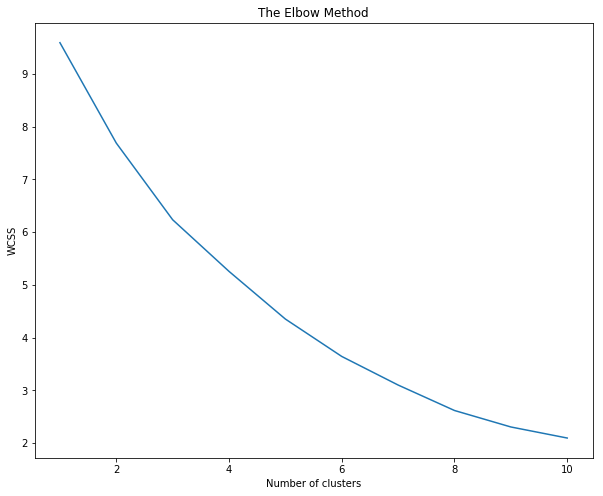

In [94]:
# find the appropriate cluster number
plt.figure(figsize=(10, 8))
from sklearn.cluster import KMeans
wcss = []
for i in range(1, 11):
    kmeans = KMeans(n_clusters = i, init = 'k-means++', random_state = 42)
    kmeans.fit(doc_topic)
    wcss.append(kmeans.inertia_)
plt.plot(range(1, 11), wcss)
plt.title('The Elbow Method')
plt.xlabel('Number of clusters')
plt.ylabel('WCSS')
plt.show()


In [95]:
# Visualize the topics
pyLDAvis.enable_notebook()
vis = pyLDAvis.gensim.prepare(lda_model, corpus, id2word)
vis

/Users/nicksherwin/anaconda3/lib/python3.7/site-packages/pyLDAvis/_prepare.py:257: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  return pd.concat([default_term_info] + list(topic_dfs))


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
1      0.153520  0.012739       1        1  69.516991
2      0.130044 -0.046158       2        1  14.225597
4      0.015732 -0.080048       3        1   7.235017
3     -0.014743  0.139333       4        1   6.991570
0     -0.284553 -0.025866       5        1   2.030823, topic_info=      Category         Freq            Term        Total  loglift  logprob
38     Default  5861.000000              be  5861.000000  30.0000  30.0000
333    Default  6665.000000             not  6665.000000  29.0000  29.0000
200    Default  4641.000000             get  4641.000000  28.0000  28.0000
408    Default  3926.000000               s  3926.000000  27.0000  27.0000
206    Default  4193.000000              go  4193.000000  26.0000  26.0000
141    Default  4094.000000              do  4094.000000  25.0000  25.0000
222    Default  1872.000000            have  1872.000000  24.0000  24.0000
263    Default  2757.000000            know  2757.000000  23.0000  23.0000
285    Default  1703.000000            look  1703.000000  22.0000  22.0000
103    Default  1720.000000            come  1720.000000  21.0000  21.0000
295    Default  1101.000000            make  1101.000000  20.0000  20.0000
566    Default   248.000000            baby   248.000000  19.0000  19.0000
208    Default  1030.000000            good  1030.000000  18.0000  18.0000
275    Default  1173.000000             let  1173.000000  17.0000  17.0000
734    Default   358.000000            ship   358.000000  16.0000  16.0000
245    Default   865.000000             ill   865.000000  15.0000  15.0000
476    Default  1422.000000            take  1422.000000  14.0000  14.0000
228    Default   583.000000            help   583.000000  13.0000  13.0000
1526   Default   130.000000            king   130.000000  12.0000  12.0000
419    Default  1564.000000             see  1564.000000  11.0000  11.0000
213    Default   534.000000             guy   534.000000  10.0000  10.0000
113    Default   844.000000           could   844.000000   9.0000   9.0000
487    Default  1610.000000           think  1610.000000   8.0000   8.0000
326    Default   662.000000            need   662.000000   7.0000   7.0000
412    Default  1243.000000             say  1243.000000   6.0000   6.0000
31     Default  1183.000000            back  1183.000000   5.0000   5.0000
535    Default  1198.000000            well  1198.000000   4.0000   4.0000
690    Default   430.000000            must   430.000000   3.0000   3.0000
568    Default   489.000000            beat   489.000000   2.0000   2.0000
4430   Default   120.000000         cameron   120.000000   1.0000   1.0000
...        ...          ...             ...          ...      ...      ...
4469    Topic5    41.897251           holme    45.909191   3.8053  -4.7272
13296   Topic5     6.501991          hobbit     7.197176   3.7951  -6.5903
10795   Topic5     6.501640          jesuit     7.197390   3.7951  -6.5903
14771   Topic5     6.499933        lestrade     7.196887   3.7949  -6.5906
11015   Topic5     5.970728    north_island     6.667284   3.7864  -6.6755
851     Topic5    12.594250        cardinal    14.096858   3.7840  -5.9292
9359    Topic5     9.683168          milady    10.899700   3.7784  -6.1920
13139   Topic5     5.440963           omura     6.136403   3.7764  -6.7684
13301   Topic5     5.440996          mordor     6.136623   3.7764  -6.7684
13285   Topic5     5.440739  final_revision     6.136771   3.7763  -6.7685
10762   Topic5     4.910824        bastille     5.606281   3.7643  -6.8710
14509   Topic5     4.910429         vizzini     5.606621   3.7641  -6.8710
13584   Topic5     4.380536          calais     5.075859   3.7494  -6.9852
13267   Topic5     4.380158          baggin     5.076014   3.7493  -6.9853
14493   Topic5     4.380075          fezzik     5.076278   3.7492  -6.9853
11964   Topic5    11.159147           irene    14.4290

## LDA (Cleaned Dialogue List)

In [96]:
def sent_to_words(sentences):
    for sentence in sentences:
        yield(gensim.utils.simple_preprocess(str(sentence), deacc=True))  # deacc=True removes punctuations

data_words = list(sent_to_words(cleaned_dialogue_list))

print(data_words[:1])

[['nearly', 'miss', 'hey', 'east', 'pike', 'come', 'along', 'aron', 'nice', 'meet', 'day', 'bike', 'come', 'straight', 'trail', 'head', 'leave', 'mine', 'horseshoe', 'canyon', 'bike', 'lot', 'not', 'expect', 'see', 'anyone', 'canyon', 'today', 'yeah', 'know', 'mean', 'no', 'one', 'around', 'mile', 'let', 'guess', 'painting', 'cathedral', 'climb', 'little', 'tricky', 'worth', 'thousand', 'hold', 'not', 'see', 'almost', 'upside', 'keep', 'appear', 'bit', 'act', 'faith', 'ill', 'go', 'first', 'take', 'much', 'dare', 'bit', 'surprise', 'end', 'swear', 'not', 'look', 'swear', 'not', 'care', 'get', 'thing', 'get', 'middle', 'not', 'well', 'not', 'really', 'anyone', 'special', 'winter', 'solo', 'ascent', 'well', 'figure', 'no', 'one', 'else', 'mad', 'enough', 'climb', 'winter', 'like', 'solitude', 'great', 'tune', 'empty', 'mind', 'sing', 'phish', 'song', 'loud', 'like', 'yeah', 'know', 'know', 'ill', 'get', 'leave', 'no', 'trace', 'hey', 'like', 'beer', 'like', 'next', 'man', 'know', 'end', 

In [97]:
# Build the bigram and trigram models
bigram = gensim.models.Phrases(data_words, min_count=5, threshold=100) # higher threshold fewer phrases.
trigram = gensim.models.Phrases(bigram[data_words], threshold=100)  

# Faster way to get a sentence clubbed as a trigram/bigram
bigram_mod = gensim.models.phrases.Phraser(bigram)
trigram_mod = gensim.models.phrases.Phraser(trigram)

# See trigram example
print(trigram_mod[bigram_mod[data_words[0]]])

/Users/nicksherwin/anaconda3/lib/python3.7/site-packages/gensim/models/phrases.py:494: UserWarning: For a faster implementation, use the gensim.models.phrases.Phraser class
  warnings.warn("For a faster implementation, use the gensim.models.phrases.Phraser class")
/Users/nicksherwin/anaconda3/lib/python3.7/site-packages/gensim/models/phrases.py:494: UserWarning: For a faster implementation, use the gensim.models.phrases.Phraser class
  warnings.warn("For a faster implementation, use the gensim.models.phrases.Phraser class")
/Users/nicksherwin/anaconda3/lib/python3.7/site-packages/gensim/models/phrases.py:494: UserWarning: For a faster implementation, use the gensim.models.phrases.Phraser class
  warnings.warn("For a faster implementation, use the gensim.models.phrases.Phraser class")
/Users/nicksherwin/anaconda3/lib/python3.7/site-packages/gensim/models/phrases.py:494: UserWarning: For a faster implementation, use the gensim.models.phrases.Phraser class
  warnings.warn("For a faster im

/Users/nicksherwin/anaconda3/lib/python3.7/site-packages/gensim/models/phrases.py:494: UserWarning: For a faster implementation, use the gensim.models.phrases.Phraser class
  warnings.warn("For a faster implementation, use the gensim.models.phrases.Phraser class")
/Users/nicksherwin/anaconda3/lib/python3.7/site-packages/gensim/models/phrases.py:494: UserWarning: For a faster implementation, use the gensim.models.phrases.Phraser class
  warnings.warn("For a faster implementation, use the gensim.models.phrases.Phraser class")
/Users/nicksherwin/anaconda3/lib/python3.7/site-packages/gensim/models/phrases.py:494: UserWarning: For a faster implementation, use the gensim.models.phrases.Phraser class
  warnings.warn("For a faster implementation, use the gensim.models.phrases.Phraser class")
/Users/nicksherwin/anaconda3/lib/python3.7/site-packages/gensim/models/phrases.py:494: UserWarning: For a faster implementation, use the gensim.models.phrases.Phraser class
  warnings.warn("For a faster im

/Users/nicksherwin/anaconda3/lib/python3.7/site-packages/gensim/models/phrases.py:494: UserWarning: For a faster implementation, use the gensim.models.phrases.Phraser class
  warnings.warn("For a faster implementation, use the gensim.models.phrases.Phraser class")
/Users/nicksherwin/anaconda3/lib/python3.7/site-packages/gensim/models/phrases.py:494: UserWarning: For a faster implementation, use the gensim.models.phrases.Phraser class
  warnings.warn("For a faster implementation, use the gensim.models.phrases.Phraser class")
/Users/nicksherwin/anaconda3/lib/python3.7/site-packages/gensim/models/phrases.py:494: UserWarning: For a faster implementation, use the gensim.models.phrases.Phraser class
  warnings.warn("For a faster implementation, use the gensim.models.phrases.Phraser class")
/Users/nicksherwin/anaconda3/lib/python3.7/site-packages/gensim/models/phrases.py:494: UserWarning: For a faster implementation, use the gensim.models.phrases.Phraser class
  warnings.warn("For a faster im

/Users/nicksherwin/anaconda3/lib/python3.7/site-packages/gensim/models/phrases.py:494: UserWarning: For a faster implementation, use the gensim.models.phrases.Phraser class
  warnings.warn("For a faster implementation, use the gensim.models.phrases.Phraser class")
/Users/nicksherwin/anaconda3/lib/python3.7/site-packages/gensim/models/phrases.py:494: UserWarning: For a faster implementation, use the gensim.models.phrases.Phraser class
  warnings.warn("For a faster implementation, use the gensim.models.phrases.Phraser class")
/Users/nicksherwin/anaconda3/lib/python3.7/site-packages/gensim/models/phrases.py:494: UserWarning: For a faster implementation, use the gensim.models.phrases.Phraser class
  warnings.warn("For a faster implementation, use the gensim.models.phrases.Phraser class")
/Users/nicksherwin/anaconda3/lib/python3.7/site-packages/gensim/models/phrases.py:494: UserWarning: For a faster implementation, use the gensim.models.phrases.Phraser class
  warnings.warn("For a faster im

/Users/nicksherwin/anaconda3/lib/python3.7/site-packages/gensim/models/phrases.py:494: UserWarning: For a faster implementation, use the gensim.models.phrases.Phraser class
  warnings.warn("For a faster implementation, use the gensim.models.phrases.Phraser class")
/Users/nicksherwin/anaconda3/lib/python3.7/site-packages/gensim/models/phrases.py:494: UserWarning: For a faster implementation, use the gensim.models.phrases.Phraser class
  warnings.warn("For a faster implementation, use the gensim.models.phrases.Phraser class")
/Users/nicksherwin/anaconda3/lib/python3.7/site-packages/gensim/models/phrases.py:494: UserWarning: For a faster implementation, use the gensim.models.phrases.Phraser class
  warnings.warn("For a faster implementation, use the gensim.models.phrases.Phraser class")
/Users/nicksherwin/anaconda3/lib/python3.7/site-packages/gensim/models/phrases.py:494: UserWarning: For a faster implementation, use the gensim.models.phrases.Phraser class
  warnings.warn("For a faster im

['nearly', 'miss', 'hey', 'east', 'pike', 'come', 'along', 'aron', 'nice', 'meet', 'day', 'bike', 'come', 'straight', 'trail', 'head', 'leave', 'mine', 'horseshoe', 'canyon', 'bike', 'lot', 'not', 'expect', 'see', 'anyone', 'canyon', 'today', 'yeah', 'know', 'mean', 'no', 'one', 'around', 'mile', 'let', 'guess', 'painting', 'cathedral', 'climb', 'little', 'tricky', 'worth', 'thousand', 'hold', 'not', 'see', 'almost', 'upside', 'keep', 'appear', 'bit', 'act', 'faith', 'ill', 'go', 'first', 'take', 'much', 'dare', 'bit', 'surprise', 'end', 'swear', 'not', 'look', 'swear', 'not', 'care', 'get', 'thing', 'get', 'middle', 'not', 'well', 'not', 'really', 'anyone', 'special', 'winter', 'solo', 'ascent', 'well', 'figure', 'no', 'one', 'else', 'mad', 'enough', 'climb', 'winter', 'like', 'solitude', 'great', 'tune', 'empty', 'mind', 'sing', 'phish', 'song', 'loud', 'like', 'yeah', 'know', 'know', 'ill', 'get', 'leave', 'no', 'trace', 'hey', 'like', 'beer', 'like', 'next', 'man', 'know', 'end', '

In [98]:
# Define functions for stopwords, bigrams, trigrams and lemmatization
def remove_stopwords(texts):
    return [[word for word in simple_preprocess(str(doc)) if word not in stop_words] for doc in texts]

def make_bigrams(texts):
    return [bigram_mod[doc] for doc in texts]

def make_trigrams(texts):
    return [trigram_mod[bigram_mod[doc]] for doc in texts]

def lemmatization(texts, allowed_postags=['NOUN', 'ADJ', 'VERB', 'ADV']):
    """https://spacy.io/api/annotation"""
    texts_out = []
    for sent in texts:
        doc = nlp(" ".join(sent)) 
        texts_out.append([token.lemma_ for token in doc if token.pos_ in allowed_postags])
    return texts_out

In [99]:
# Remove Stop Words
data_words_nostops = remove_stopwords(data_words)

# Form Bigrams
data_words_bigrams = make_bigrams(data_words_nostops)

# Initialize spacy 'en' model, keeping only tagger component (for efficiency)
# python3 -m spacy download en
nlp = spacy.load('en', disable=['parser', 'ner'])

# Do lemmatization keeping only noun, adj, vb, adv
data_lemmatized = lemmatization(data_words_bigrams, allowed_postags=['NOUN', 'ADJ', 'VERB', 'ADV'])

print(data_lemmatized[:1])

[['nearly', 'miss', 'east', 'pike', 'come', 'aron', 'nice', 'meet', 'day', 'bike', 'come', 'straight', 'trail', 'head', 'leave', 'mine', 'horseshoe', 'canyon', 'bike', 'lot', 'expect', 'see', 'anyone', 'canyon', 'today', 'mean', 'mile', 'let', 'guess', 'paint', 'cathedral', 'climb', 'little', 'tricky', 'worth', 'hold', 'see', 'almost', 'upside', 'keep', 'appear', 'bit', 'act', 'faith', 'ill', 'go', 'first', 'take', 'much', 'dare', 'bit', 'surprise', 'end', 'swear', 'look', 'swear', 'care', 'get', 'thing', 'get', 'middle', 'well', 'really', 'anyone', 'special', 'winter', 'solo', 'ascent', 'figure', 'else', 'mad', 'enough', 'climb', 'winter', 'solitude', 'great', 'tune', 'empty', 'mind', 'sing', 'phish', 'song', 'loud', 'know', 'ill', 'get', 'leave', 'trace', 'beer', 'next', 'man', 'know', 'end', 'day', 'certify', 'yet', 'want', 'hard', 'get', 'hour', 'qualify', 'catch', 'great', 'put', 'ass', 'head', 'instructor', 'ish', 'talk', 'time', 'make', 'way', 'chimney', 'little', 'way', 'watch'

In [100]:
# Create Dictionary
id2word = corpora.Dictionary(data_lemmatized)

# Create Corpus
texts = data_lemmatized

# Term Document Frequency
corpus = [id2word.doc2bow(text) for text in texts]

# View
print(corpus[:1])

[[(0, 1), (1, 1), (2, 1), (3, 1), (4, 3), (5, 2), (6, 1), (7, 1), (8, 2), (9, 1), (10, 1), (11, 1), (12, 3), (13, 2), (14, 1), (15, 1), (16, 1), (17, 1), (18, 2), (19, 1), (20, 2), (21, 1), (22, 8), (23, 8), (24, 1), (25, 1), (26, 1), (27, 2), (28, 2), (29, 3), (30, 1), (31, 5), (32, 3), (33, 1), (34, 1), (35, 1), (36, 1), (37, 1), (38, 2), (39, 1), (40, 1), (41, 2), (42, 4), (43, 5), (44, 2), (45, 1), (46, 1), (47, 1), (48, 1), (49, 1), (50, 1), (51, 1), (52, 1), (53, 2), (54, 3), (55, 1), (56, 1), (57, 2), (58, 1), (59, 1), (60, 1), (61, 2), (62, 2), (63, 2), (64, 1), (65, 1), (66, 1), (67, 1), (68, 3), (69, 1), (70, 2), (71, 1), (72, 10), (73, 1), (74, 1), (75, 1), (76, 2), (77, 1), (78, 1), (79, 1), (80, 1), (81, 1), (82, 1), (83, 1), (84, 1), (85, 2), (86, 1), (87, 1), (88, 1), (89, 1), (90, 6), (91, 1), (92, 1), (93, 1), (94, 1), (95, 1), (96, 4), (97, 1), (98, 1), (99, 1), (100, 3), (101, 1), (102, 8), (103, 1), (104, 1), (105, 1), (106, 1), (107, 1), (108, 1), (109, 1), (110, 1

In [101]:
# Human readable format of corpus (term-frequency)
[[(id2word[id], freq) for id, freq in cp] for cp in corpus[:1]]

[[('accent', 1),
  ('account', 1),
  ('ache', 1),
  ('act', 1),
  ('actually', 3),
  ('almost', 2),
  ('already', 1),
  ('also', 1),
  ('always', 2),
  ('ambitious', 1),
  ('america', 1),
  ('american', 1),
  ('anyone', 3),
  ('anything', 2),
  ('anyway', 1),
  ('anyways', 1),
  ('anywhere', 1),
  ('apart', 1),
  ('appear', 2),
  ('apply', 1),
  ('appreciate', 2),
  ('area', 1),
  ('arm', 8),
  ('aron', 8),
  ('ascent', 1),
  ('aspen', 1),
  ('ass', 1),
  ('attempt', 2),
  ('attention', 2),
  ('away', 3),
  ('awesome', 1),
  ('back', 5),
  ('bad', 3),
  ('bag', 1),
  ('balance', 1),
  ('bank', 1),
  ('barely', 1),
  ('basement', 1),
  ('beer', 2),
  ('believe', 1),
  ('bet', 1),
  ('big', 2),
  ('bike', 4),
  ('bit', 5),
  ('bite', 2),
  ('bitterly', 1),
  ('bj', 1),
  ('black', 1),
  ('blade', 1),
  ('bleed', 1),
  ('bleeding', 1),
  ('blind', 1),
  ('blond', 1),
  ('blood', 2),
  ('blue', 3),
  ('blunt', 1),
  ('bomber', 1),
  ('bone', 2),
  ('boost', 1),
  ('bothersome', 1),
  ('bot

In [132]:
# Build LDA model
lda_model = gensim.models.ldamodel.LdaModel(corpus=corpus,
                                           id2word=id2word,
                                           num_topics=6, 
                                           random_state=100,
                                           update_every=1,
                                           chunksize=100,
                                           passes=10,
                                           alpha='auto',
                                           per_word_topics=True)

In [133]:
# Print the Keyword in the 5 topics
pprint(lda_model.print_topics())
doc_lda = lda_model[corpus]

[(0,
  '0.010*"harold" + 0.010*"bloom" + 0.007*"stephen" + 0.005*"kumar" + '
  '0.004*"penelope" + 0.004*"chink" + 0.004*"white_castle" + 0.003*"nyah" + '
  '0.003*"rold" + 0.003*"mirror"'),
 (1,
  '0.011*"fuck" + 0.007*"co" + 0.005*"shit" + 0.004*"johnny" + 0.004*"reed" + '
  '0.004*"monkey" + 0.004*"ben" + 0.003*"dave" + 0.003*"mater" + '
  '0.003*"victor"'),
 (2,
  '0.017*"go" + 0.014*"get" + 0.013*"know" + 0.009*"come" + 0.009*"would" + '
  '0.009*"think" + 0.008*"see" + 0.007*"well" + 0.007*"time" + 0.007*"look"'),
 (3,
  '0.011*"baby" + 0.011*"willow" + 0.008*"jo" + 0.008*"get" + 0.007*"ill" + '
  '0.006*"good" + 0.006*"madmartigan" + 0.006*"come" + 0.005*"go" + '
  '0.005*"peck"'),
 (4,
  '0.010*"man" + 0.008*"know" + 0.007*"would" + 0.006*"see" + 0.006*"come" + '
  '0.005*"must" + 0.005*"look" + 0.005*"take" + 0.005*"king" + 0.005*"time"'),
 (5,
  '0.031*"get" + 0.026*"go" + 0.015*"know" + 0.010*"look" + 0.010*"want" + '
  '0.009*"think" + 0.008*"see" + 0.008*"take" + 0.008*"co

In [134]:
# Compute Perplexity
print('\nPerplexity: ', lda_model.log_perplexity(corpus))  # a measure of how good the model is. lower the better.

# Compute Coherence Score
coherence_model_lda = CoherenceModel(model=lda_model, texts=data_lemmatized, dictionary=id2word, coherence='c_v')
coherence_lda = coherence_model_lda.get_coherence()
print('\nCoherence Score: ', coherence_lda)


Perplexity:  -7.741084626142719

Coherence Score:  0.3331300522242


## pyLDAvis

In [119]:
# Visualize the topics
pyLDAvis.enable_notebook()
vis = pyLDAvis.gensim.prepare(lda_model, corpus, id2word)
vis



/Users/nicksherwin/anaconda3/lib/python3.7/site-packages/pyLDAvis/_prepare.py:257: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  return pd.concat([default_term_info] + list(topic_dfs))


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
1     -0.026033 -0.016489       1        1  40.894009
2      0.090681 -0.055694       2        1  25.529289
0      0.023873  0.097967       3        1  23.183294
3     -0.088520 -0.025784       4        1  10.393410, topic_info=      Category         Freq       Term        Total  loglift  logprob
198    Default  4464.000000        get  4464.000000  30.0000  30.0000
204    Default  3960.000000         go  3960.000000  29.0000  29.0000
259    Default  2573.000000       know  2573.000000  28.0000  28.0000
920    Default   224.000000       gold   224.000000  27.0000  27.0000
536    Default  1540.000000      would  1540.000000  26.0000  26.0000
191    Default   386.000000       fuck   386.000000  25.0000  25.0000
211    Default   578.000000        guy   578.000000  24.0000  24.0000
519    Default  1396.000000       want  1396.000000  23.0000  23.0000
558    Default   255.000000       baby   255.000000  22.0000  22.0000
480    Default  1576.000000      think  1576.000000  21.0000  21.0000
112    Default   916.000000      could   916.000000  20.0000  20.0000
255    Default   599.000000       kill   599.000000  19.0000  19.0000
102    Default  1567.000000       come  1567.000000  18.0000  18.0000
10494  Default    92.000000      iraqi    92.000000  17.0000  17.0000
720    Default   355.000000       ship   355.000000  16.0000  16.0000
10482  Default    76.000000        epp    76.000000  15.0000  15.0000
4303   Default   154.000000    cameron   154.000000  14.0000  14.0000
1443   Default   128.000000      datum   128.000000  13.0000  13.0000
73     Default   319.000000        car   319.000000  12.0000  12.0000
15594  Default    74.000000     willow    74.000000  11.0000  11.0000
225    Default   415.000000       hell   415.000000  10.0000  10.0000
270    Default  1105.000000        let  1105.000000   9.0000   9.0000
172    Default   771.000000       find   771.000000   8.0000   8.0000
1285   Default   408.000000      maybe   408.000000   7.0000   7.0000
1454   Default   116.000000        eli   116.000000   6.0000   6.0000
420    Default   225.000000       shit   225.000000   5.0000   5.0000
291    Default  1019.000000        man  1019.000000   4.0000   4.0000
523    Default   862.000000        way   862.000000   3.0000   3.0000
1442   Default    97.000000  dartagnan    97.000000   2.0000   2.0000
406    Default  1150.000000        say  1150.000000   1.0000   1.0000
...        ...          ...        ...          ...      ...      ...
204     Topic4   536.959534         go  3960.917725   0.2657  -3.7030
1284    Topic4    51.274349        map   113.801865   1.4667  -6.0517
198     Topic4   550.496155        get  4464.307617   0.1709  -3.6781
259     Topic4   326.325928       know  2573.160400   0.1990  -4.2010
1133    Topic4    62.077396        war   175.282272   1.2260  -5.8605
519     Topic4   202.235672       want  1396.146851   0.3320  -4.6794
536     Topic4   209.467941      would  1540.752563   0.2685  -4.6443
255     Topic4   119.670319       kill   599.018188   0.6534  -5.2041
2522    Topic4    51.162102       boat   135.612015   1.2892  -6.0539
480     Topic4   195.084122      think  1576.203979   0.1747  -4.7155
112     Topic4   132.029800      could   916.236816   0.3268  -5.1059
102     Topic4   164.064392       come  1567.443604   0.0071  -4.8886
270     Topic4   134.122665        let  1105.374878   0.1548  -5.0901
225     Topic4    82.067696       hell   415.562714   0.6419  -5.5813
280     Topic4   155.084106       look  1637.771484  -0.0931  -4.9449
172     Topic4   108.763596       find   771.293030   0.3051  -5.2997
406     Topic4   129.700180        say  1150.058472   0.0817  -5.1237
413     Topic4   140.961227        see  1515.188232  -0.1108  -5.0404
470     Topic4   133.892502       take  1406.397949  -0.0878  -5.0918
523     Topic4   106.778267        way   862.279602   0.1752  -

## Conclusions

We see from the above that while we were not able to cluster by personalities in the Adventure genre we were able to uncover some insight. Namely, we have uncovered the toxicity of action protagonists. We see many commanding and mysogonist words throughout the corpus, especially in topic 1. 

In [107]:
pyLDAvis.save_html(vis, 'lda.html')
